In [2]:
from textblob import TextBlob
import pandas as pd
import numpy as np
import os

import statistics

In [38]:
# choose a lexicon based sentiment classifier for ever comment with Co-occurrance. Possibly compare
# more than one classifier, described below.

In [40]:
df = pd.read_csv('cooccurrance_df.csv')

C:\Users\kodri\AppData\Local\Temp\ipykernel_25972\1257135964.py:1: DtypeWarning: Columns (54) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('cooccurrance_df.csv')


### upload city dictionary for locating toponym

In [3]:
city_variation_df = pd.read_csv('city_variations.csv')
city_variation_df = city_variation_df[:39]

cols = ['eng', 'local', 'wiki', 'col']
city_dict = {}
for i, row in city_variation_df.iterrows():    
    city_dict[row['col']] = [row['eng'], row['local'], row['wiki']]

## PARIS

In [15]:
df = pd.read_csv('cooccurrance_df.csv')

city_variation_df = pd.read_csv('city_variations.csv')
city_variation_df = city_variation_df[:39]

#remove cities with <1million population
df = df[df['Paris']==1]
cols1 = ['doc','line', 'created_utc', ' score',' subreddit',' link_id',' subreddit_id']
cols2 = list(city_variation_df['col'])
cols = cols1 + cols2
df = df[cols]


C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\890458164.py:1: DtypeWarning: Columns (54) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('cooccurrance_df.csv')


In [24]:
#create year and month columns
df['year'] = df['doc'].apply(lambda x: int(x[:4]))
df['month'] = df['doc'].apply(lambda x: int(x[5:]))

In [26]:
#add body 
path = r"C:\Users\kodri\Desktop\CITYNET Europe\occurrances"
body = []
doc = df.iloc[0]['doc']
file = "RC_" + doc + '.txt'
fp = os.path.join(path, file)
with open(fp, 'r', encoding = 'utf-8') as f:
    comments = f.read().split('\n--------\n')
    
for idx, row in df.iterrows():

    if row['doc'] == doc:
        line = row['line']
        text = comments[line].split(',')[-2]
        body.append(text)
    else:
        doc = row['doc']
        file = "RC_" + doc + '.txt'
        fp = os.path.join(path, file)
        with open(fp, 'r', encoding = 'utf-8') as f:
            comments = f.read().split('\n--------\n')
            line = row['line']
            text = comments[line].split(',')[-2]
            body.append(text)

df['body'] = body

In [28]:
#add sentiment info
df['blob'] = df['body'].apply(lambda x: TextBlob(x))
df['num_sentences'] = df['blob'].apply(lambda x: len(x.sentences))
df['polarity'] = df['blob'].apply(lambda x: x.sentiment[0])
df['subjectivity'] = df['blob'].apply(lambda x: x.sentiment[1])

In [ ]:
#remove the rows with no co-occurrences when extra cities are gone
df['occ_sum'] = df[cols2].sum(axis = 1)
df = df[df['occ_sum']>1]
df = df[cols]

In [56]:
#convert sentences to lower and search for lower case toponym
#handle multiple occurrences of toponym - get n-gram and sentiment, take a mean

In [57]:
#identify index of toponym 
sentence_idx = []
for blob in df['blob']:
    idx = []
    for i, s in enumerate(blob.sentences):
        if 'paris' in s.lower():
            idx.append(i)
    if len(idx) > 1:
        for j in idx[1:]:
            
df['sent_idx'] = sentence_idx

In [92]:
len(df['sent_idx'].iloc[1])

2

In [93]:
#create a row for each sentence with an occurrence

for idx, row in df.iterrows():
    if len(row['sent_idx'])>1:
        for j in row['sent_idx']:
            new_row = row.copy()
            new_row['sent_idx'] = j
            df.append(new_row)

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df.append(new_row)
C:\Users\kodri\AppData\Local\Temp\ipykernel_11840\2079942547.py:8: FutureWarning: The frame.append method is depreca

In [63]:
#do tf-idf on n-gram (3 or 5)

In [ ]:
df['polarity'] = df['blob'].apply(lambda x: x.sentiment[0])
df['subjectivity'] = df['blob'].apply(lambda x: x.sentiment[1])

In [87]:
df

,doc,line,created_utc,score,subreddit,link_id,subreddit_id,Paris,London,Madrid,...,year,month,body,blob,num_sentences,polarity,subjectivity,sent_idx,sent_pol,sent_sub
1,2006-02,8,1139517217,4,reddit.com,t3_1dp6,t5_6,1,0,0,...,2006,2,Ryanair has been doing this for years advertis...,"(R, y, a, n, a, i, r, , h, a, s, , b, e, e, ...",4,0.233654,0.500000,[0],0.050000,0.533333
3,2006-04,46,1146234649,1,reddit.com,t3_5y81a,t5_6,1,0,0,...,2006,4,Maybe it's just me but I do believe that you c...,"(M, a, y, b, e, , i, t, ', s, , j, u, s, t, ...",3,0.100000,0.300000,"[0, 1]",0.000000,0.250000
4,2006-04,45,1146212582,3,reddit.com,t3_5y81a,t5_6,1,0,0,...,2006,4,I'm from Barcelona and I'm living in France. I...,"(I, ', m, , f, r, o, m, , B, a, r, c, e, l, ...",5,0.173636,0.400000,[3],0.227273,0.420000
5,2006-04,22,1144908432,1,reddit.com,t3_4b3w,t5_6,1,1,0,...,2006,4,Quality of Living vs. the quality of life\n \n...,"(Q, u, a, l, i, t, y, , o, f, , L, i, v, i, ...",5,0.124470,0.440135,[1],0.155455,0.443535
6,2006-04,42,1146177212,2,reddit.com,t3_5y81a,t5_6,1,1,0,...,2006,4,I would only consider living in one the of fol...,"(I, , w, o, u, l, d, , o, n, l, y, , c, o, ...",4,-0.001515,0.527778,[2],0.175000,0.325000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1230191,2021-01,99623,1610391877,1,worldnews,t3_kv4umb,t5_2qh13,1,1,0,...,2021,1,The great part was that you could get a $100 p...,"(T, h, e, , g, r, e, a, t, , p, a, r, t, , ...",3,0.255833,0.470357,[1],0.000000,0.000000
1230196,2021-01,99880,1610393302,3,IMDbFilmGeneral,t3_kv1wv3,t5_3iwyp,1,0,0,...,2021,1,The year 2000 didn’t mark our world’s end a...,"( , , , T, h, e, , y, e, a, r, , 2, 0, 0, ...",43,0.165696,0.549676,"[25, 27]",0.202604,0.550000
1230199,2021-01,99311,1610389456,3,space,t3_kv6n7i,t5_2qh87,1,1,0,...,2021,1,And yet even in London I had no option other t...,"(A, n, d, , y, e, t, , e, v, e, n, , i, n, ...",2,0.437500,0.337500,[1],1.000000,0.300000
1230203,2021-01,99687,1610392312,1,gaming,t3_kv8xwg,t5_2qh03,1,1,0,...,2021,1,Depends what country we heard rumours of a Gta...,"(D, e, p, e, n, d, s, , w, h, a, t, , c, o, ...",5,-0.112662,0.571104,[3],-0.714286,0.857143


In [86]:
#get n-grams of first occurrence

[0]                            56858
[1]                            37114
[2]                            22990
[3]                            15320
[5]                            10410
                               ...  
[1, 6, 14, 21]                     1
[9, 11, 16, 20, 21, 22, 23]        1
[9, 11, 16, 20, 21, 22, 24]        1
[3, 4, 15, 17, 20]                 1
[23, 24, 35]                       1
Name: sent_idx, Length: 6078, dtype: int64

In [76]:
#for each sentence with a toponym occurrence calculate sentiment and calculate comment average if more than 1 occurrence
sent_pol = []
sent_sub = []
for idx, row in df.iterrows():
    indices = row['sent_idx']
    pol = []
    sub = []
    for i in indices:
        sentence = row['blob'].sentences[i]
        pol.append(sentence.sentiment[0])
        sub.append(sentence.sentiment[1])
    sent_pol.append(statistics.mean(pol))
    sent_sub.append(statistics.mean(sub))

In [81]:
df['sent_pol'] = sent_pol
df['sent_sub'] = sent_sub

In [84]:
df['blob'].iloc[2].sentences[1].words

WordList(['If', 'you', 'think', 'that', 'in', 'average', 'in', 'Barcelona', 'more', 'people', 'speak', 'English', 'than', 'in', 'France', 'you', 'do', "n't", 'know', 'well', 'neither', 'of', 'these', 'countries'])

In [37]:
#tut: https://github.com/shubhamjn1/TextBlob/blob/master/Textblob.ipynb
#TextBlob based on NLTK
# also https://www.analyticsvidhya.com/blog/2021/01/sentiment-analysis-vader-or-textblob/

In [95]:
df.to_csv('paris_disambiguation_df.csv')

### Get body feature

In [30]:
blob = TextBlob("Analytics Vidhya is a great platform to learn data science.")
for np in blob.noun_phrases:
    print (np)

for words, tag in blob.tags:
    print (words, tag)

analytics vidhya
great platform
data science
Analytics NNS
Vidhya NNP
is VBZ
a DT
great JJ
platform NN
to TO
learn VB
data NNS
science NN


In [36]:
comment = "Barely-literate knitting needle Paris Hilton has been out and about in London visiting several gigs and parties. During the various journeys Paris has been smoking some VERY strong skunk. So if you see a big shiny Merc and smell the weed have a look inside you might see a red-eyed Hilton with a joint on the go."
blob = TextBlob(comment)
print (blob)
blob.sentiment

Barely-literate knitting needle Paris Hilton has been out and about in London visiting several gigs and parties. During the various journeys Paris has been smoking some VERY strong skunk. So if you see a big shiny Merc and smell the weed have a look inside you might see a red-eyed Hilton with a joint on the go.


Sentiment(polarity=0.14083333333333334, subjectivity=0.3883333333333333)

## Vader

In [32]:
# tut: https://www.analyticsvidhya.com/blog/2021/10/sentiment-analysis-with-textblob-and-vader/

In [25]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

In [35]:
sid_obj= SentimentIntensityAnalyzer()

print(sid_obj.polarity_scores(comment)) 

{'neg': 0.053, 'neu': 0.843, 'pos': 0.104, 'compound': 0.5308}


## K-means 

In [102]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()  # for plot styling
import numpy as np
import re

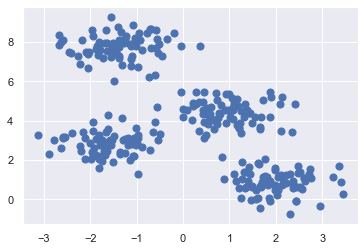

In [98]:
from sklearn.datasets import make_blobs
X, y_true = make_blobs(n_samples=300, centers=4,
                       cluster_std=0.60, random_state=0)
plt.scatter(X[:, 0], X[:, 1], s=50);

In [ ]:
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from nltk import pos_tag
nltk.download('stopwords')
from nltk.corpus import stopwords
nltk.download('wordnet')
from nltk.corpus import wordnet
import nltk
nltk.download('omw-1.4')

In [96]:
text = 'In this step, we need to remove the special characters, numbers from the text. We can use the regular expression operations library of Python.'

In [100]:
X.shape

(300, 2)

In [103]:
def clean(text):
# Removes all special characters and numericals leaving the alphabets
    text = re.sub('[^A-Za-z]+', ' ', text)
    return text

# Cleaning the text in the review column
clean_text = clean(text)

In [104]:
# POS tagger dictionary
import time 
pos_dict = {'J':wordnet.ADJ, 'V':wordnet.VERB, 'N':wordnet.NOUN, 'R':wordnet.ADV}
def token_stop_pos(text):
    tags = pos_tag(word_tokenize(text))
    newlist = []
    for word, tag in tags:
        if word.lower() not in set(stopwords.words('english')):
            newlist.append(tuple([word, pos_dict.get(tag[0])]))
    return newlist
start = time.time()
for i in range (1000):
    a = token_stop_pos(clean_text)

end = time.time()

print(end-start)
print('seconds')

NameError: name 'wordnet' is not defined